Nou còdec: lz4
    
Còdecs: blosclz, zstd i lz4
    
CONCLUSIONS: blosclz sempre és millor que lz4. Llevem blosclz

Còdecs: zstd i lz4

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
import numpy as np
import aux_funcs

In [2]:
from pathlib import Path
path = Path('../data_inputs_temp/')

In [3]:
ficheros = ['entropy-shuffle', 'zstd-shuffle-split', 'lz4-shuffle-split']
categories = ["31", "0", "1"]

dataframes1 = {}
for i in range(len(ficheros)):
    dataframes1[ficheros[i]] = aux_funcs.get_filtered_df(path, ficheros[i], category=categories[i])

In [4]:
path = Path('../data_inputs')

dataframes2 = {}
for i in range(len(ficheros)):
    dataframes2[ficheros[i]] = aux_funcs.get_filtered_df(path, ficheros[i], category=categories[i])

In [5]:
path = Path('../data_inputs_wind/')

dataframes3 = {}
for i in range(len(ficheros)):
    dataframes3[ficheros[i]] = aux_funcs.get_filtered_df(path, ficheros[i], category=categories[i])

In [6]:
df_fig = pd.DataFrame()
for i in range(0, len(ficheros)):
    df_fig = pd.concat([df_fig, dataframes1[ficheros[i]]], axis = 0)
    df_fig = pd.concat([df_fig, dataframes2[ficheros[i]]], axis = 0)
    df_fig = pd.concat([df_fig, dataframes3[ficheros[i]]], axis = 0)

df_fig

,cratio,speed,special_vals,nchunk,category,codec_filter,categoria
0,16400.00,5.410000e+09,1,0,-1,entropy-shuffle,31
1,2.02,2.340000e+09,0,0,-1,entropy-shuffle,31
2,5.73,5.700000e+09,0,0,-1,entropy-shuffle,31
3,13100.00,5.410000e+09,1,0,-1,entropy-shuffle,31
4,16400.00,5.410000e+09,1,0,-1,entropy-shuffle,31
...,...,...,...,...,...,...,...
55291,16400.00,5.560000e+09,1,215,4,lz4-shuffle-split,1
55292,16400.00,5.560000e+09,1,215,4,lz4-shuffle-split,1
55293,16400.00,5.560000e+09,1,215,4,lz4-shuffle-split,1
55294,16400.00,5.600000e+09,1,215,4,lz4-shuffle-split,1


In [7]:
df_fig = df_fig[df_fig['special_vals'] == 0]

In [8]:
fig = px.scatter(df_fig, "cratio", "speed", color = "categoria")
fig.show()

0: zstd

1: lz4

# DATAFRAME FILTRE shuffle

In [9]:
df_entropy = pd.DataFrame()
df_entropy = pd.concat([df_entropy, dataframes1[ficheros[0]], dataframes2[ficheros[0]], 
                       dataframes3[ficheros[0]]], axis = 0)

df_entropy.rename(columns = {'cratio':'cratio31', 'speed':'speed31', 'special_vals':'special_vals31'}, inplace = True)
df_entropy = df_entropy.drop(['nchunk', 'category', 'codec_filter', 'categoria'], axis = 1)

In [10]:
df_zstd = pd.DataFrame()
df_zstd = pd.concat([df_zstd, dataframes1[ficheros[1]], dataframes2[ficheros[1]], 
                       dataframes3[ficheros[1]]], axis = 0)

df_zstd.rename(columns = {'cratio':'cratio0', 'speed':'speed0', 'special_vals':'special_vals0'}, inplace = True)
df_zstd = df_zstd.drop(['nchunk', 'category', 'codec_filter', 'categoria'], axis = 1)

In [11]:
df_lz4 = pd.DataFrame()
df_lz4 = pd.concat([df_lz4, dataframes1[ficheros[2]], dataframes2[ficheros[2]], 
                        dataframes3[ficheros[2]]], axis = 0)

df_lz4.rename(columns = {'cratio':'cratio1', 'speed':'speed1', 'special_vals':'special_vals1'}, inplace = True)
df_lz4 = df_lz4.drop(['nchunk', 'category', 'codec_filter', 'categoria'], axis = 1)

In [12]:
df_shuffle = pd.DataFrame()
df_shuffle = pd.concat([df_shuffle, df_zstd, df_lz4, df_entropy], axis = 1)
df_shuffle

,cratio0,speed0,special_vals0,cratio1,speed1,special_vals1,cratio31,speed31,special_vals31
0,16400.0,5.520000e+09,1,16400.00,5.540000e+09,1,16400.00,5.410000e+09,1
1,4.9,6.950000e+06,0,1.96,1.740000e+08,0,2.02,2.340000e+09,0
2,17.1,1.850000e+07,0,4.94,3.590000e+08,0,5.73,5.700000e+09,0
3,13100.0,5.520000e+09,1,13100.00,5.560000e+09,1,13100.00,5.410000e+09,1
4,16400.0,5.540000e+09,1,16400.00,5.580000e+09,1,16400.00,5.410000e+09,1
...,...,...,...,...,...,...,...,...,...
55291,16400.0,5.580000e+09,1,16400.00,5.560000e+09,1,16400.00,5.410000e+09,1
55292,16400.0,5.460000e+09,1,16400.00,5.560000e+09,1,16400.00,5.310000e+09,1
55293,16400.0,5.440000e+09,1,16400.00,5.560000e+09,1,16400.00,5.540000e+09,1
55294,16400.0,5.460000e+09,1,16400.00,5.600000e+09,1,16400.00,5.580000e+09,1


Eliminar special_value (que lo sea en alguna de las 3 categorías)

In [13]:
df_shuffle = aux_funcs.delete_special_vals(df_shuffle, ["special_vals0", "special_vals1", "special_vals31"])

In [14]:
df_input_x = df_shuffle.iloc[:, [6, 7]]

In [15]:
df_input_x

,cratio31,speed31
1,2.02,2.340000e+09
2,5.73,5.700000e+09
5,2.11,2.700000e+09
6,6.10,6.340000e+09
9,2.23,2.710000e+09
...,...,...
55203,21.80,1.440000e+10
55206,3.70,4.770000e+09
55207,19.00,1.380000e+10
55210,3.99,5.190000e+09


Cálculo del SCORE

In [16]:
df_shuffle = df_shuffle.drop(['cratio31', 'speed31', 'special_vals31', 'special_vals0', 'special_vals1'], axis = 1)

In [17]:
df_shuffle

,cratio0,speed0,cratio1,speed1
1,4.90,6950000.0,1.96,1.740000e+08
2,17.10,18500000.0,4.94,3.590000e+08
5,4.95,7130000.0,1.96,1.750000e+08
6,18.20,19600000.0,5.01,3.690000e+08
9,5.17,7130000.0,2.00,1.800000e+08
...,...,...,...,...
55203,152.00,64000000.0,44.40,1.770000e+09
55206,13.30,25300000.0,7.32,4.940000e+08
55207,148.00,62000000.0,43.50,1.770000e+09
55210,29.90,61200000.0,16.10,9.040000e+08


In [18]:
dfcratios = pd.DataFrame()
for i in range(0, 2):
    dfcratios = pd.concat([dfcratios, df_shuffle.iloc[:, 2*i]], axis =0)

In [19]:
desv_cratio = dfcratios.std()[0]
desv_cratio

240.08923362842316

In [20]:
mean_cratio = dfcratios.mean()[0]
mean_cratio

51.39156438883543

In [21]:
dfspeeds = pd.DataFrame()
for i in range(0, 2):
    dfspeeds = pd.concat([dfspeeds, df_shuffle.iloc[:, 2*i+1]], axis =0)

In [22]:
mean_speed = dfspeeds.mean()[0]
mean_speed

241891518.63971767

In [23]:
desv_speed = dfspeeds.std()[0]
desv_speed

475101035.30903524

In [24]:
theta = 0.95

cratio0 = df_shuffle["cratio0"]
speed0 = df_shuffle["speed0"]
ncratio0 = (cratio0 - mean_cratio) / desv_cratio
nspeed0 = (speed0 - mean_speed) / desv_speed
df_shuffle.insert(2, 0, theta*ncratio0 + (1-theta)*nspeed0)

cratio1 = df_shuffle["cratio1"]
speed1 = df_shuffle["speed1"]
ncratio1 = (cratio1 - mean_cratio) / desv_cratio
nspeed1 = (speed1 - mean_speed) / desv_speed
df_shuffle.insert(5, 1, theta*ncratio1 + (1-theta)*nspeed1)

In [25]:
df_shuffle

,cratio0,speed0,0,cratio1,speed1,1
1,4.90,6950000.0,-0.208686,1.96,1.740000e+08,-0.202739
2,17.10,18500000.0,-0.159197,4.94,3.590000e+08,-0.171478
5,4.95,7130000.0,-0.208469,1.96,1.750000e+08,-0.202634
6,18.20,19600000.0,-0.154729,5.01,3.690000e+08,-0.170148
9,5.17,7130000.0,-0.207599,2.00,1.800000e+08,-0.201949
...,...,...,...,...,...,...
55203,152.00,64000000.0,0.379372,44.40,1.770000e+09,0.133155
55206,13.30,25300000.0,-0.173517,7.32,4.940000e+08,-0.147853
55207,148.00,62000000.0,0.363334,43.50,1.770000e+09,0.129593
55210,29.90,61200000.0,-0.104055,16.10,9.040000e+08,-0.069963


In [26]:
df_pos = df_shuffle
df_pos = df_pos.drop(['cratio0', 'speed0', 'cratio1', 'speed1'], axis = 1)

In [27]:
df_pos

,0,1
1,-0.208686,-0.202739
2,-0.159197,-0.171478
5,-0.208469,-0.202634
6,-0.154729,-0.170148
9,-0.207599,-0.201949
...,...,...
55203,0.379372,0.133155
55206,-0.173517,-0.147853
55207,0.363334,0.129593
55210,-0.104055,-0.069963


EJERCICIO TOIA

In [28]:
col = df_pos.iloc[:, 0]
df = col.to_frame(name='punct')
df

df_0 = pd.DataFrame()
df_0 = pd.concat([df_0, df], axis = 0)
categoria = np.repeat(str(0), 77925)
df_0['categoria'] = categoria
df_0

,punct,categoria
1,-0.208686,0
2,-0.159197,0
5,-0.208469,0
6,-0.154729,0
9,-0.207599,0
...,...,...
55203,0.379372,0
55206,-0.173517,0
55207,0.363334,0
55210,-0.104055,0


In [29]:
col = df_pos.iloc[:, 1]
df = col.to_frame(name='punct')
df

df_1 = pd.DataFrame()
df_1 = pd.concat([df_1, df], axis = 0)
categoria = np.repeat('1', 77925)
df_1['categoria'] = categoria
df_1

,punct,categoria
1,-0.202739,1
2,-0.171478,1
5,-0.202634,1
6,-0.170148,1
9,-0.201949,1
...,...,...
55203,0.133155,1
55206,-0.147853,1
55207,0.129593,1
55210,-0.069963,1


In [30]:
df_fig = pd.DataFrame()
df_fig = pd.concat([df_fig, df_0, df_1], axis = 0)
df_fig

,punct,categoria
1,-0.208686,0
2,-0.159197,0
5,-0.208469,0
6,-0.154729,0
9,-0.207599,0
...,...,...
55203,0.133155,1
55206,-0.147853,1
55207,0.129593,1
55210,-0.069963,1


In [31]:
fig = px.scatter(df_fig, "punct", "categoria", color = "categoria")
fig.show()

FIN EJERCICIO

In [32]:
best_categ_shuffle = df_pos.idxmax(axis=1)
best_categ_shuffle = pd.DataFrame(best_categ_shuffle, columns=['best_categ'])
best_categ_shuffle

,best_categ
1,1
2,0
5,1
6,0
9,1
...,...
55203,0
55206,1
55207,0
55210,1


In [33]:
categorias = best_categ_shuffle['best_categ'].unique()

In [34]:
unique, counts = np.unique(best_categ_shuffle, return_counts=True)
result = np.column_stack((unique, counts))
result

array([[    0, 33261],
       [    1, 44664]])

In [35]:
df_t = pd.DataFrame()
df_t = pd.concat([df_t, df_input_x['cratio31']], axis = 1)
df_t = pd.concat([df_t, df_input_x['speed31']], axis = 1)
df_t = pd.concat([df_t, best_categ_shuffle], axis = 1)
df_t

,cratio31,speed31,best_categ
1,2.02,2.340000e+09,1
2,5.73,5.700000e+09,0
5,2.11,2.700000e+09,1
6,6.10,6.340000e+09,0
9,2.23,2.710000e+09,1
...,...,...,...
55203,21.80,1.440000e+10,0
55206,3.70,4.770000e+09,1
55207,19.00,1.380000e+10,0
55210,3.99,5.190000e+09,1


Balancear

In [36]:
df_blc = pd.DataFrame()
for i in categorias:
    df_i = df_t[df_t['best_categ'] == i]
    df_i = df_i.head(n=33261)
    df_blc = pd.concat([df_blc, df_i], axis = 0)
        
df_blc

,cratio31,speed31,best_categ
1,2.02,2.340000e+09,1
5,2.11,2.700000e+09,1
9,2.23,2.710000e+09,1
13,2.37,2.810000e+09,1
17,1.29,1.990000e+09,1
...,...,...,...
55191,7.85,8.110000e+09,0
55195,6.27,6.340000e+09,0
55203,21.80,1.440000e+10,0
55207,19.00,1.380000e+10,0


In [37]:
dfinput_y = pd.DataFrame()
dfinput_y = pd.concat([dfinput_y, df_blc['best_categ']], axis = 1)
dfinput_y.shape

(66522, 1)

In [38]:
dfinput_x = df_blc.drop(['best_categ'], axis = 1)
dfinput_x.shape

(66522, 2)

Normalizar inputs

In [39]:
dfcratios = pd.DataFrame()
dfcratios = pd.concat([dfcratios, dfinput_x.iloc[:, 0]], axis =0)

In [40]:
desv_cratio = dfcratios.std()[0]
desv_cratio

42.63295132129702

In [41]:
mean_cratio = dfcratios.mean()[0]
mean_cratio

20.51878325967349

In [42]:
dfspeeds = pd.DataFrame()
dfspeeds = pd.concat([dfspeeds, dfinput_x.iloc[:, 1]], axis =0)

In [43]:
mean_speed = dfspeeds.mean()[0]
mean_speed

6669194430.413999

In [44]:
desv_speed = dfspeeds.std()[0]
desv_speed

5382514272.190403

In [45]:
dfinput_x

,cratio31,speed31
1,2.02,2.340000e+09
5,2.11,2.700000e+09
9,2.23,2.710000e+09
13,2.37,2.810000e+09
17,1.29,1.990000e+09
...,...,...
55191,7.85,8.110000e+09
55195,6.27,6.340000e+09
55203,21.80,1.440000e+10
55207,19.00,1.380000e+10


In [46]:
cratio = dfinput_x["cratio31"]
speed = dfinput_x["speed31"]
ncratio = (cratio - mean_cratio) / desv_cratio
nspeed = (speed - mean_speed) / desv_speed

dfinput_x_norm = pd.DataFrame()
dfinput_x_norm.insert(0, "ncratio", ncratio)
dfinput_x_norm.insert(1, "nspeed", nspeed)

In [47]:
dfinput_x_norm

,ncratio,nspeed
1,-0.433908,-0.804307
5,-0.431797,-0.737424
9,-0.428982,-0.735566
13,-0.425698,-0.716987
17,-0.451031,-0.869332
...,...,...
55191,-0.297159,0.267683
55195,-0.334220,-0.061160
55203,0.030052,1.436281
55207,-0.035625,1.324809


In [48]:
dfinput_x = dfinput_x_norm

In [49]:
dfinput_y

,best_categ
1,1
5,1
9,1
13,1
17,1
...,...
55191,0
55195,0
55203,0
55207,0


In [50]:
#dfinput_x = dfinput_x.to_csv('dfinput_x.csv')
#dfinput_y = dfinput_y.to_csv('dfinput_y.csv')

In [51]:
dfinput_y

,best_categ
1,1
5,1
9,1
13,1
17,1
...,...
55191,0
55195,0
55203,0
55207,0


In [52]:
dfinput_x.shape

(66522, 2)

In [53]:
dfinput_y.shape

(66522, 1)

# RED NEURONAL (2 categorías)

In [54]:
from keras.utils import to_categorical
dfinput_y = to_categorical(dfinput_y)

2022-12-28 12:04:05.171105: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [55]:
from keras import models, layers
import tensorflow

tensorflow.random.set_seed(100)

model = models.Sequential()
model.add(layers.Dense(2, activation='relu', input_shape=(2,)))
model.add(layers.Dense(25, activation='relu'))
model.add(layers.Dense(2, activation='softmax'))

2022-12-28 12:04:11.398968: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [56]:
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['acc'])

In [57]:
history = model.fit(dfinput_x, dfinput_y, epochs=35, validation_split=0.1)

Epoch 1/35
1871/1871 [==============================] - 6s 3ms/step - loss: 0.4044 - acc: 0.8239 - val_loss: 0.2095 - val_acc: 0.9539
Epoch 2/35
1871/1871 [==============================] - 4s 2ms/step - loss: 0.3834 - acc: 0.8327 - val_loss: 0.2085 - val_acc: 0.9633
Epoch 3/35
1871/1871 [==============================] - 6s 3ms/step - loss: 0.3802 - acc: 0.8336 - val_loss: 0.2127 - val_acc: 0.9662
Epoch 4/35
1871/1871 [==============================] - 6s 3ms/step - loss: 0.3781 - acc: 0.8344 - val_loss: 0.2018 - val_acc: 0.9681
Epoch 5/35
1871/1871 [==============================] - 4s 2ms/step - loss: 0.3758 - acc: 0.8348 - val_loss: 0.2241 - val_acc: 0.9617
Epoch 6/35
1871/1871 [==============================] - 4s 2ms/step - loss: 0.3734 - acc: 0.8352 - val_loss: 0.2042 - val_acc: 0.9684
Epoch 7/35
1871/1871 [==============================] - 5s 3ms/step - loss: 0.3711 - acc: 0.8357 - val_loss: 0.1895 - val_acc: 0.9772
Epoch 8/35
1871/1871 [==============================] - 5s 3ms

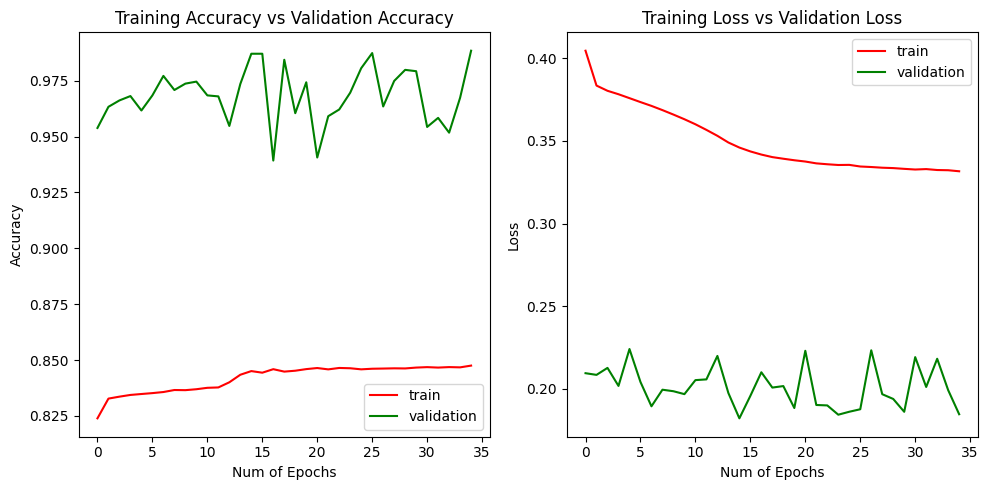

In [58]:
_, ax = plt.subplots(1, 2, figsize=(10, 5), dpi=100)
ax[0].plot(history.history['acc'], 'r')
ax[0].plot(history.history['val_acc'], 'g')
ax[0].set_xlabel("Num of Epochs")
ax[0].set_ylabel("Accuracy")
ax[0].set_title("Training Accuracy vs Validation Accuracy")
ax[0].legend(['train', 'validation'])

ax[1].plot(history.history['loss'], 'r')
ax[1].plot(history.history['val_loss'], 'g')
ax[1].set_xlabel("Num of Epochs")
ax[1].set_ylabel("Loss")
ax[1].set_title("Training Loss vs Validation Loss")
ax[1].legend(['train', 'validation'])

plt.tight_layout()

In [59]:
y_hat = model.predict(x=dfinput_x)
y_hat

2079/2079 [==============================] - 2s 1ms/step


array([[0.08493651, 0.91506356],
       [0.09858929, 0.9014107 ],
       [0.1506782 , 0.8493218 ],
       ...,
       [0.91343313, 0.0865669 ],
       [0.91343313, 0.0865669 ],
       [0.91343313, 0.0865669 ]], dtype=float32)

In [60]:
y_pred_label = np.argmax(y_hat, axis = 1)
y_true_label = np.argmax(dfinput_y, axis = 1)

In [61]:
y_pred_label

array([1, 1, 1, ..., 0, 0, 0])

In [62]:
unique, counts = np.unique(y_pred_label, return_counts=True)
result = np.column_stack((unique, counts))
result

array([[    0, 39231],
       [    1, 27291]])

In [63]:
y_true_label

array([1, 1, 1, ..., 0, 0, 0])

In [64]:
unique, counts = np.unique(y_true_label, return_counts=True)
result = np.column_stack((unique, counts))
result

array([[    0, 33261],
       [    1, 33261]])

In [65]:
tabla = pd.crosstab(y_pred_label, y_true_label)
tabla



col_0,0,1
row_0,,
0,31588,7643
1,1673,25618
